In [1]:
#load libreries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from statsmodels.tsa.stattools import adfuller
from scipy import stats
from sklearn.metrics import mean_squared_error
from statsmodels.tsa.arima_model import ARIMA
from keras.models import Sequential
from keras.layers import LSTM, Dense
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split

#load dataset and initial view
df=pd.read_csv("./data/train.csv")
df.head()


,ID,date,Item Id,Item Name,ad_spend,anarix_id,units,unit_price
0,2022-04-12_B09KDTS4DC,2022-04-12,B09KDTS4DC,"NapQueen Elizabeth 8"" Gel Memory Foam Mattress...",NaN,NAPQUEEN,0.0,0.0
1,2022-04-12_B09MR2MLZH,2022-04-12,B09MR2MLZH,NapQueen 12 Inch Bamboo Charcoal Queen Size Me...,NaN,NAPQUEEN,0.0,0.0
2,2022-04-12_B09KSYL73R,2022-04-12,B09KSYL73R,"NapQueen Elsa 8"" Innerspring Mattress, Twin XL",NaN,NAPQUEEN,0.0,0.0
3,2022-04-12_B09KT5HMNY,2022-04-12,B09KT5HMNY,"NapQueen Elsa 6"" Innerspring Mattress, Twin",NaN,NAPQUEEN,0.0,0.0
4,2022-04-12_B09KTF8ZDQ,2022-04-12,B09KTF8ZDQ,"NapQueen Elsa 6"" Innerspring Mattress, Twin XL",NaN,NAPQUEEN,0.0,0.0


In [2]:
#initial analysis
df.info()
print("\n")
print("Data describtion: \n",df.describe())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101490 entries, 0 to 101489
Data columns (total 8 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   ID          101490 non-null  object 
 1   date        101490 non-null  object 
 2   Item Id     101488 non-null  object 
 3   Item Name   99658 non-null   object 
 4   ad_spend    77303 non-null   float64
 5   anarix_id   101490 non-null  object 
 6   units       83592 non-null   float64
 7   unit_price  101490 non-null  float64
dtypes: float64(3), object(5)
memory usage: 6.2+ MB


Data describtion: 
            ad_spend         units     unit_price
count  77303.000000  83592.000000  101490.000000
mean     110.771470     10.284381     106.750922
std      529.303777     68.945915     425.704733
min        0.000000   -173.000000   -8232.000000
25%        0.000000      0.000000       0.000000
50%        4.230000      1.000000       0.000000
75%       44.310000      5.000000       0.000000
max 

In [3]:
#null values and maipulation
df['date'] = pd.to_datetime(df['date'], errors='coerce') 
print(df.isna().sum())

ID                0
date              0
Item Id           2
Item Name      1832
ad_spend      24187
anarix_id         0
units         17898
unit_price        0
dtype: int64


In [4]:
#Since we are focusing on units and Item Id and they have null values we change them
df['units'] = df['units'].fillna(0)
#Since there can be a correlation between ad_spend and units sold we remove the nulls with 0
df['ad_spend'] = df['ad_spend'].fillna(0)
df = df[df['Item Id'].notnull() & (df['Item Id'] != '')]
print(df.isna().sum())#check
# Check if there are any negative values in the 'units' column
has_negative_units = (df['units'] < 0).any()

print("Are there any negative values in 'units_price' column?", has_negative_units)

ID               0
date             0
Item Id          0
Item Name     1830
ad_spend         0
anarix_id        0
units            0
unit_price       0
dtype: int64
Are there any negative values in 'units_price' column? True


In [5]:
# Convert negative values in 'units' column to 0
df['units'] = df['units'].apply(lambda x: max(x, 0))

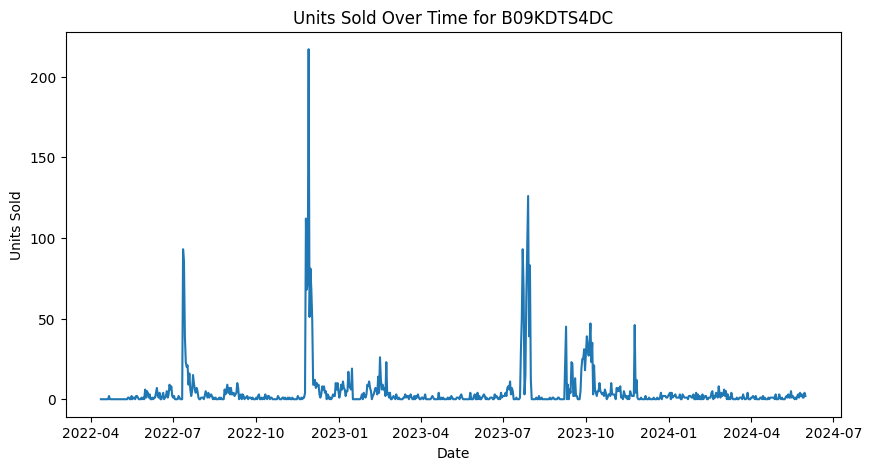

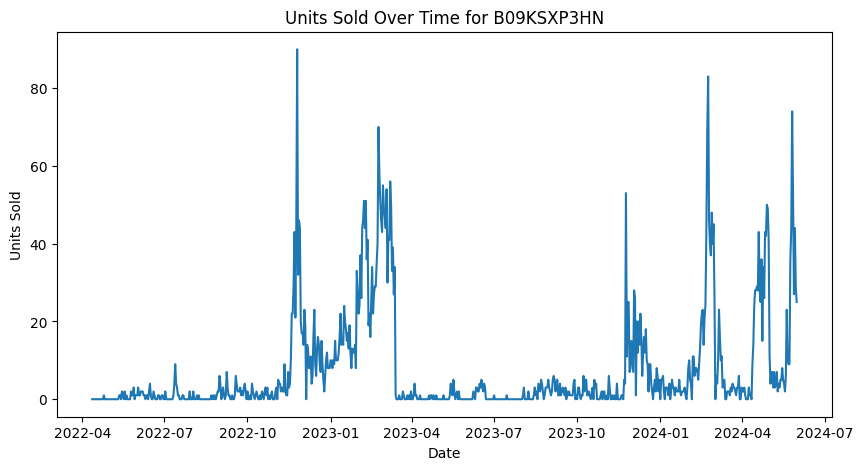

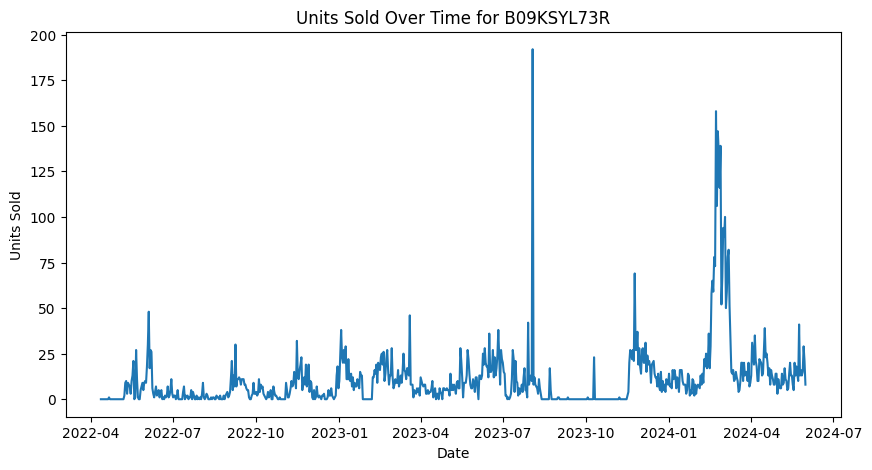

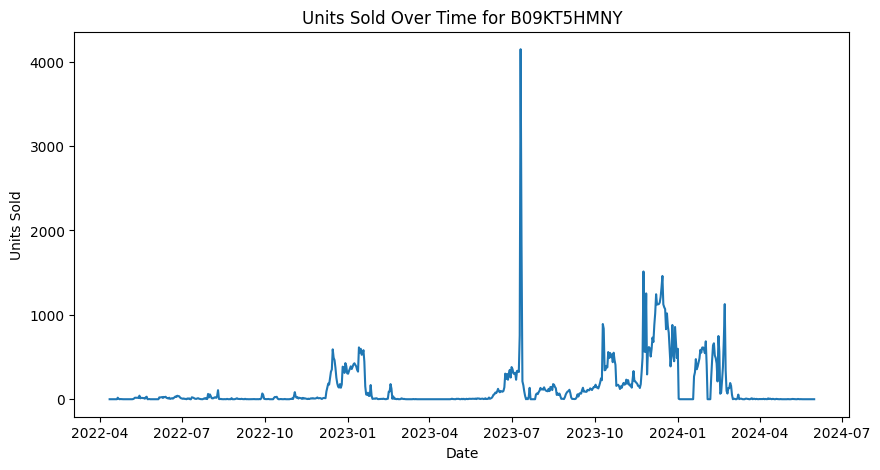

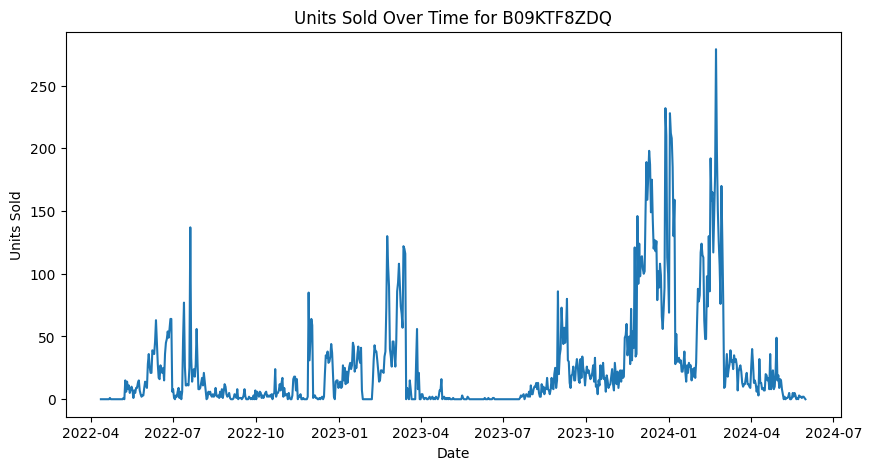

...

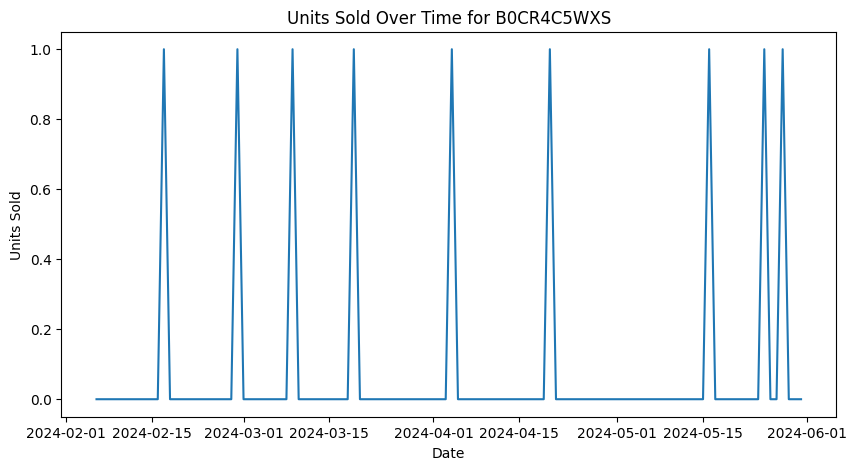

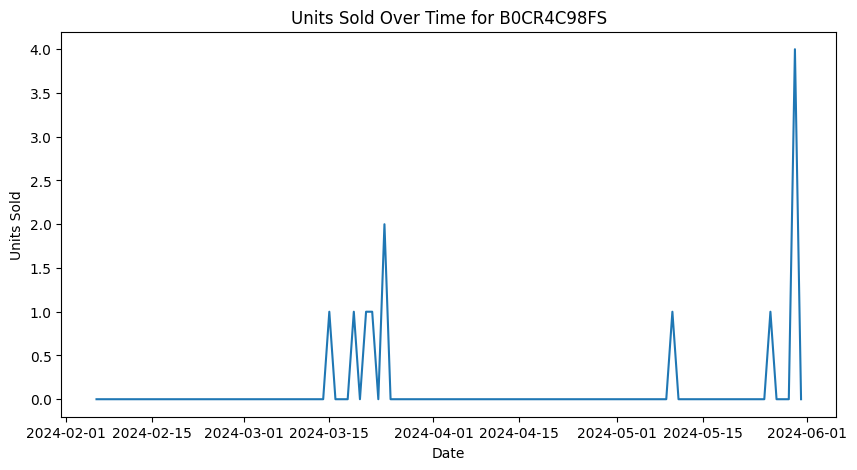

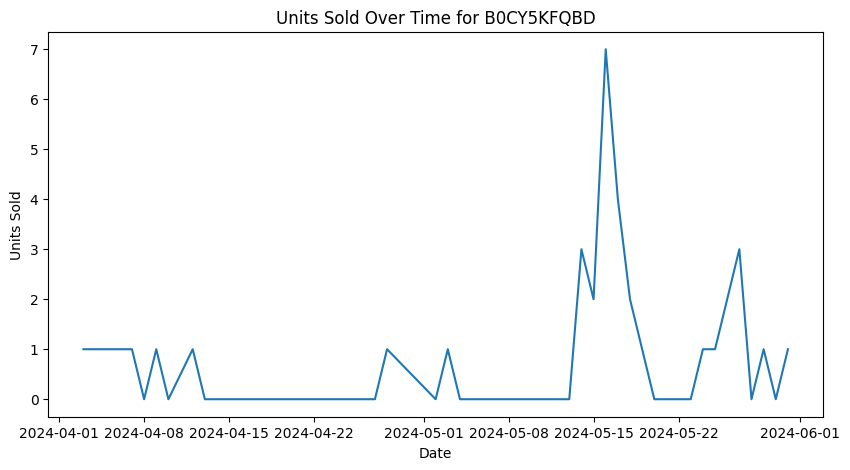

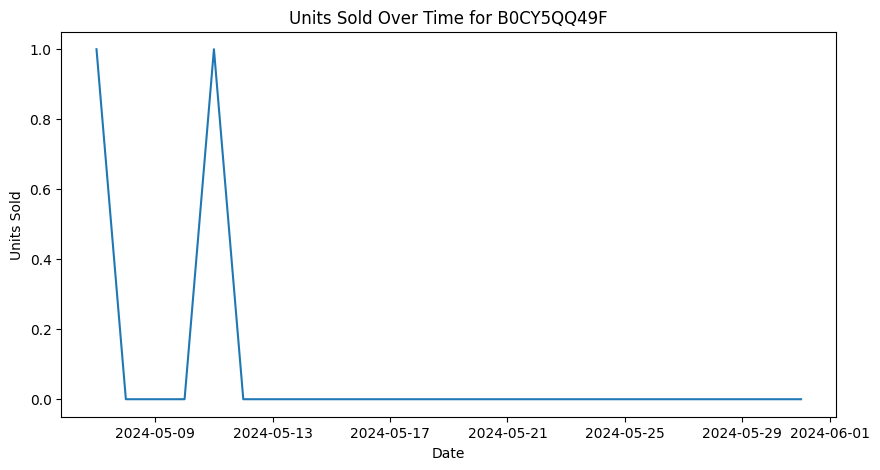

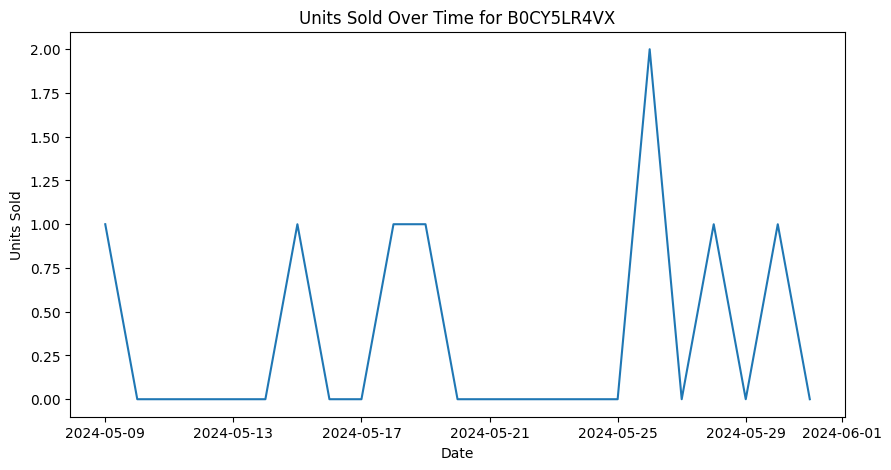

In [6]:
df_agg = df.groupby(['date', 'Item Id']).agg({'units': 'sum'}).reset_index()

# Visualize the time series
for item_id in df_agg['Item Id'].unique():
    df_item = df_agg[df_agg['Item Id'] == item_id]
    plt.figure(figsize=(10, 5))
    plt.plot(df_item['date'], df_item['units'])
    plt.title(f'Units Sold Over Time for {item_id}')
    plt.xlabel('Date')
    plt.ylabel('Units Sold')
    plt.show()

C:\Users\shrey\AppData\Local\Temp\ipykernel_21228\3212783661.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 5))


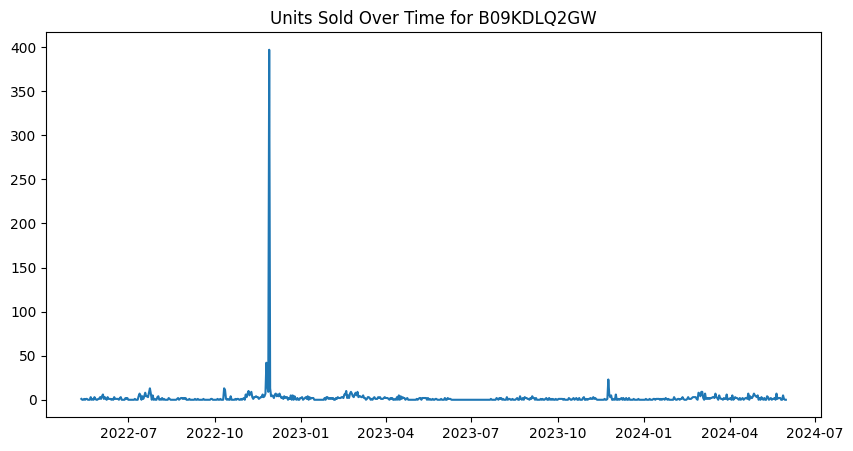

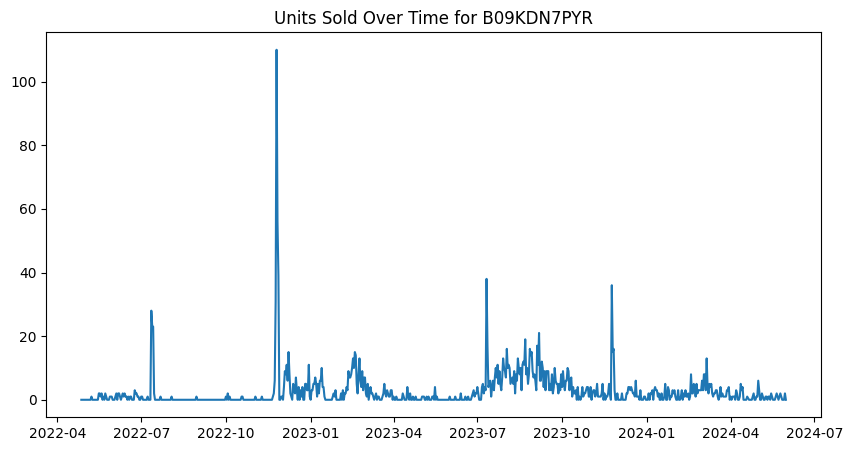

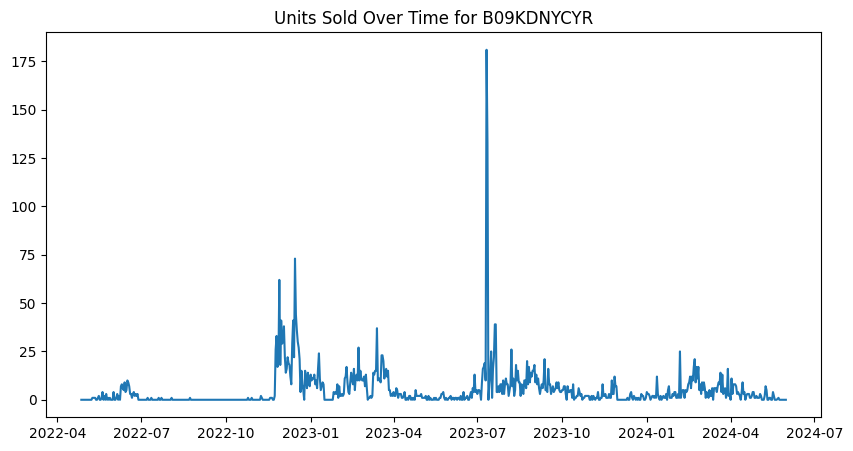

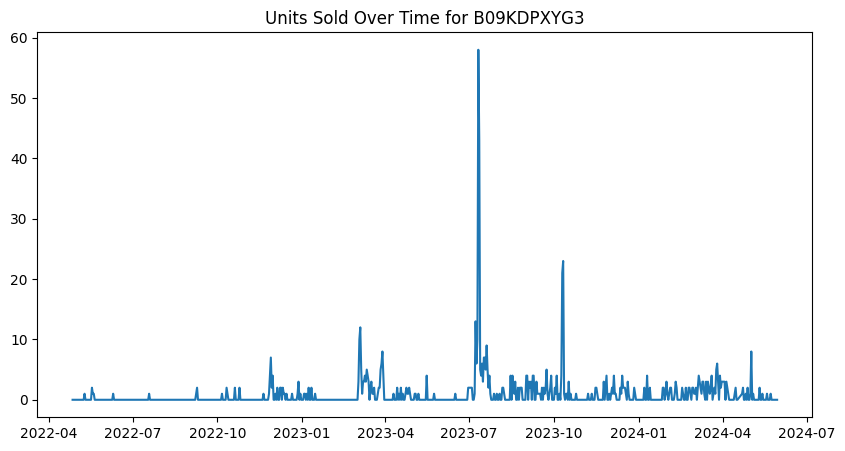

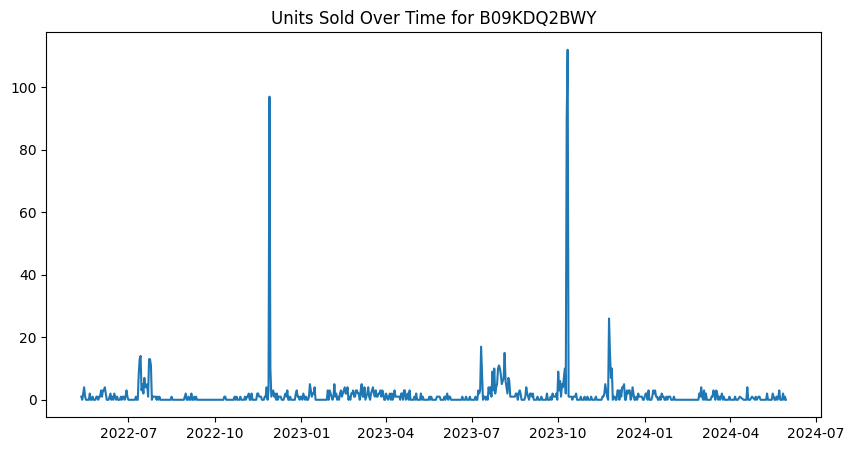

...

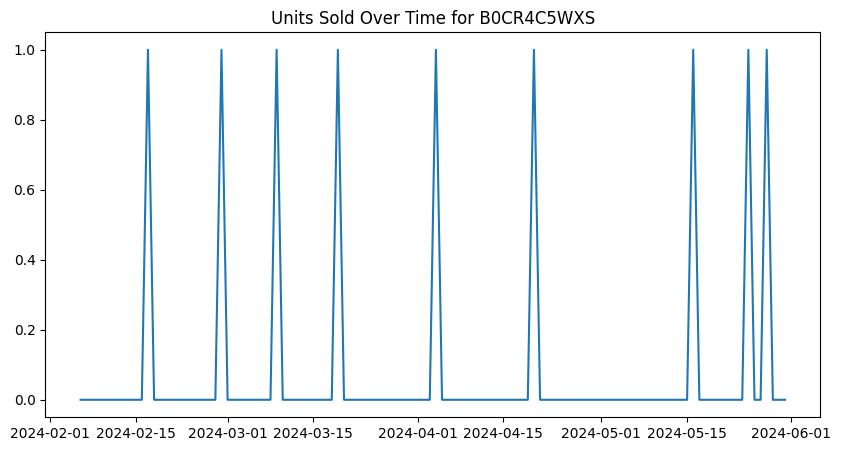

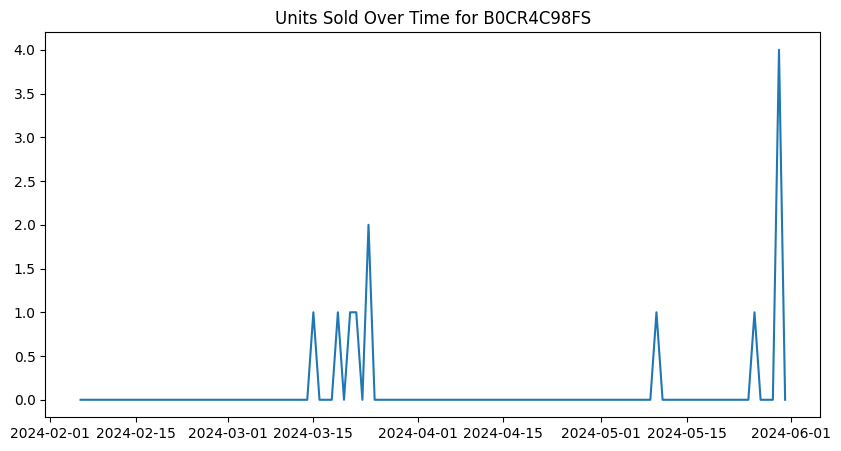

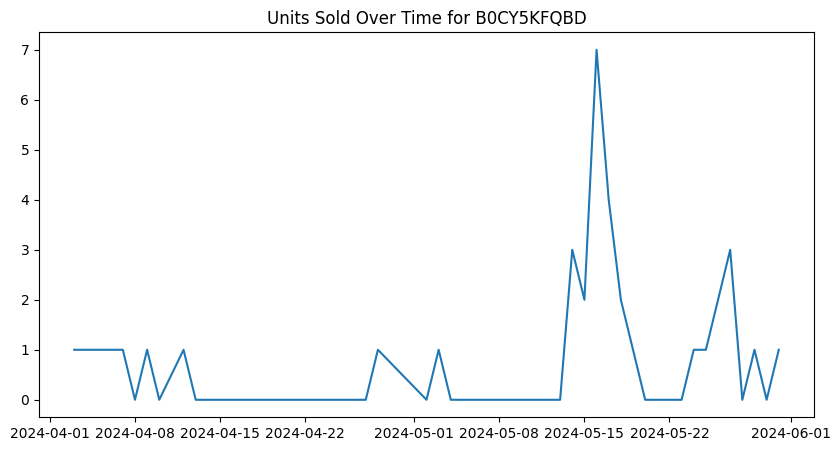

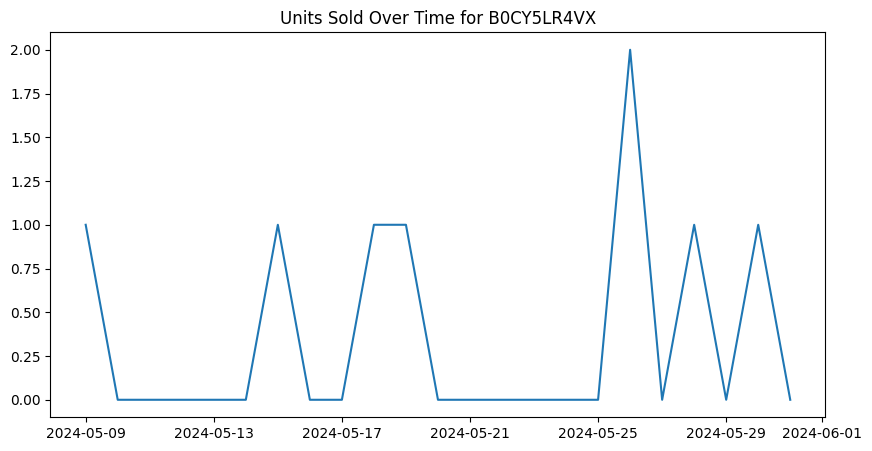

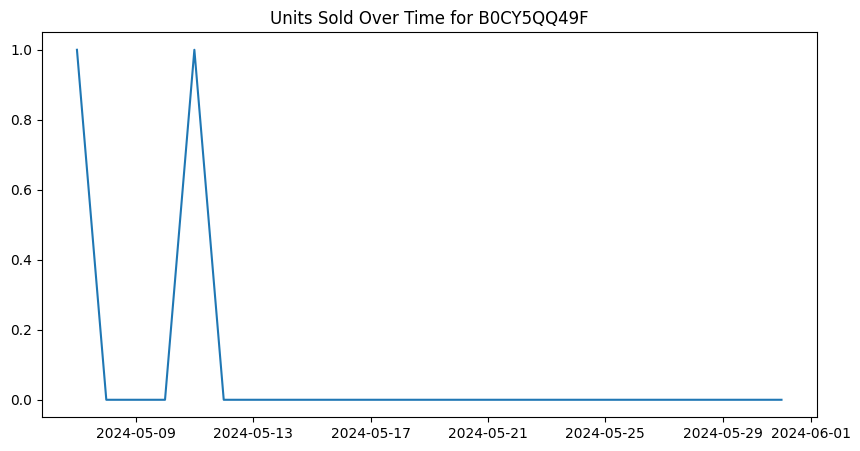

In [7]:
# Group by 'Item Id' and calculate the total sales for each item
total_sales = df.groupby('Item Id')['units'].sum()

# Filter out items with total sales of 0
items_with_sales = total_sales[total_sales > 0].index

# Remove items with 0 sales
df_filtered = df[df['Item Id'].isin(items_with_sales)]

# Visualize the sales for each item

for item_id in items_with_sales:
    df_item = df_filtered[df_filtered['Item Id'] == item_id]
    plt.figure(figsize=(10, 5))
    plt.plot(df_item['date'], df_item['units'])
    plt.title(f'Units Sold Over Time for {item_id}')

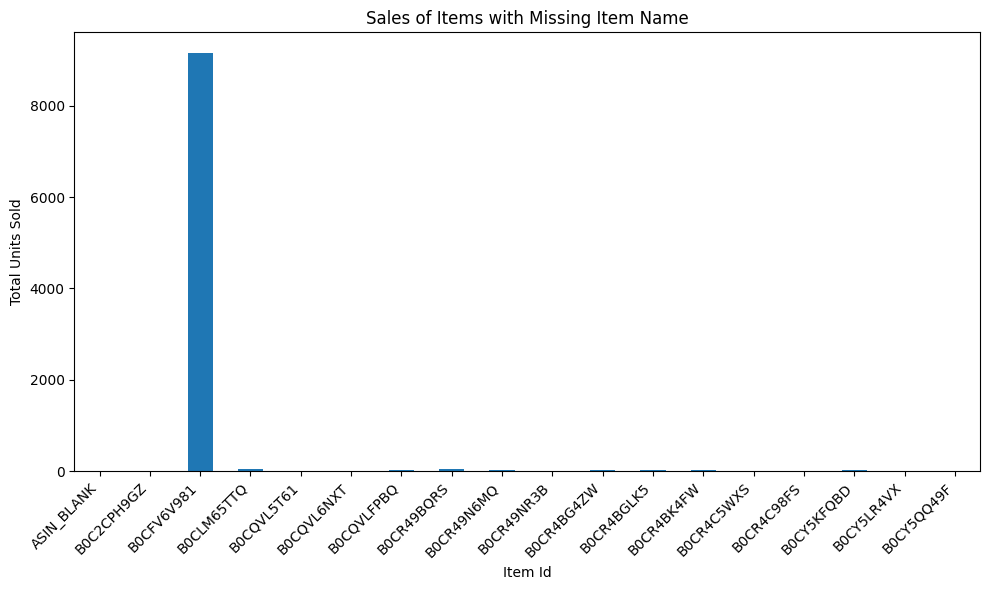

In [8]:
# Identify items with missing 'Item Name'
missing_item_name = df[df['Item Name'].isna()]

# Aggregate sales (units) by 'Item Id' for items with missing 'Item Name'
sales_by_item_id = missing_item_name.groupby('Item Id')['units'].sum()

# Plot the sales data
plt.figure(figsize=(10, 6))
sales_by_item_id.plot(kind='bar')
plt.title('Sales of Items with Missing Item Name')
plt.xlabel('Item Id')
plt.ylabel('Total Units Sold')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


In [9]:
# Identify items with 0 sales and no name
items_to_remove = df[(df['units'] == 0) & (df['Item Name'].isna())]

# Print the items to be removed (for verification)
print("Items to be removed:")
print(items_to_remove)

# Remove these items from the DataFrame
df_filtered = df[~df.index.isin(items_to_remove.index)]

Items to be removed:
                           ID       date     Item Id Item Name  ad_spend  \
57040   2023-08-20_B0CFV6V981 2023-08-20  B0CFV6V981       NaN      0.00   
57298   2023-08-21_B0CFV6V981 2023-08-21  B0CFV6V981       NaN      0.00   
57479   2023-08-22_B0CFV6V981 2023-08-22  B0CFV6V981       NaN      0.00   
61721   2023-09-16_B0CFV6V981 2023-09-16  B0CFV6V981       NaN    106.14   
62150   2023-09-19_B0CFV6V981 2023-09-19  B0CFV6V981       NaN    104.33   
...                       ...        ...         ...       ...       ...   
101483  2024-05-31_B0CR4C5WXS 2024-05-31  B0CR4C5WXS       NaN      0.00   
101485  2024-05-31_B0CR4BGLK5 2024-05-31  B0CR4BGLK5       NaN    604.73   
101487  2024-05-31_B0CR49NR3B 2024-05-31  B0CR49NR3B       NaN      0.00   
101488  2024-05-31_B0CR49N6MQ 2024-05-31  B0CR49N6MQ       NaN      0.00   
101489  2024-05-31_B0CR4BK4FW 2024-05-31  B0CR4BK4FW       NaN      0.00   

       anarix_id  units  unit_price  
57040   NAPQUEEN    0.0     

In [10]:
def adfuller_test(sales):
    if len(sales) == 0 or sales.nunique() <= 1:
        print("Data is constant or empty, cannot perform ADF test.")
        return False
    result = adfuller(sales)
    labels = ['ADF Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used']
    for value, label in zip(result, labels):
        print(label + ' : ' + str(value))
    if result[1] <= 0.05:
        print("Strong evidence against the null hypothesis (Ho), reject the null hypothesis. Data has no unit root and is stationary.\n")
        return True
    else:
        print("Weak evidence against the null hypothesis, time series has a unit root, indicating it is non-stationary.\n")
        return False
    

In [11]:
# Check stationarity for all items and collect non-stationary items
non_stationary_items = []
item_ids = df['Item Id'].unique()

for item_id in item_ids:
    print(f"Checking Item Id: {item_id}")
    df_item = df[df['Item Id'] == item_id]
    df_item_agg = df_item.groupby(['date']).agg({'units': 'sum'}).reset_index()
    df_item_agg['day_of_week'] = df_item_agg['date'].dt.dayofweek
    df_item_agg['month'] = df_item_agg['date'].dt.month
    df_item_agg['lag_1'] = df_item_agg['units'].shift(1)
    df_item_agg['rolling_mean_7'] = df_item_agg['units'].rolling(window=7).mean()
    df_item_agg['rolling_std_7'] = df_item_agg['units'].rolling(window=7).std()
    df_item_agg = df_item_agg.dropna()

    # Perform ADF test and determine if data is stationary
    is_stationary = adfuller_test(df_item_agg['units'])
    if not is_stationary:
        non_stationary_items.append(item_id)

count_of_items_not_sold_throughout=0
# Summary of results
if non_stationary_items:
    print("The following items are non-stationary based on the ADF test:")
    for item in non_stationary_items:
        # Check if any units have been sold throughout the time period
        df_non_stationary_item = df[df['Item Id'] == item]
        if df_non_stationary_item['units'].gt(0).any():
            print(f"Item Id {item} has sold units at some point in its time period.")
        else:
            count_of_items_not_sold_throughout += 1
            print(f"Item Id {item} has not sold any units throughout its time period.")
    # Identify items with no sales
    items_with_no_sales = [item for item in non_stationary_items if df[df['Item Id'] == item]['units'].eq(0).all()]

    # Remove these items from the original DataFrame
    df_cleaned = df[~df['Item Id'].isin(items_with_no_sales)]
    
    # Reset the index of the cleaned DataFrame
    df_cleaned = df_cleaned.reset_index(drop=True)
    
    print("Removed items with no sales. DataFrame index has been reset.")

Checking Item Id: B09KDTS4DC
ADF Test Statistic : -8.676556273523245
p-value : 4.4002230335175435e-14
#Lags Used : 3
Number of Observations Used : 770
Strong evidence against the null hypothesis (Ho), reject the null hypothesis. Data has no unit root and is stationary.

Checking Item Id: B09MR2MLZH
ADF Test Statistic : -3.501540908899434
p-value : 0.007947608332026193
#Lags Used : 16
Number of Observations Used : 758
Strong evidence against the null hypothesis (Ho), reject the null hypothesis. Data has no unit root and is stationary.

Checking Item Id: B09KSYL73R
ADF Test Statistic : -4.836065281092163
p-value : 4.6374017988683046e-05
#Lags Used : 5
Number of Observations Used : 753
Strong evidence against the null hypothesis (Ho), reject the null hypothesis. Data has no unit root and is stationary.

Checking Item Id: B09KT5HMNY
ADF Test Statistic : -4.665859879389226
p-value : 9.749838218711704e-05
#Lags Used : 6
Number of Observations Used : 767
Strong evidence against the null hypot

c:\Python311\Lib\site-packages\statsmodels\regression\linear_model.py:957: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2


ADF Test Statistic : -10.583005244258405
p-value : 6.828678126685861e-19
#Lags Used : 0
Number of Observations Used : 112
Strong evidence against the null hypothesis (Ho), reject the null hypothesis. Data has no unit root and is stationary.

Checking Item Id: B0CQVLFPBQ
ADF Test Statistic : -6.55030529287563
p-value : 8.885369605514421e-09
#Lags Used : 0
Number of Observations Used : 113
Strong evidence against the null hypothesis (Ho), reject the null hypothesis. Data has no unit root and is stationary.

Checking Item Id: B0CR4BK4FW
ADF Test Statistic : -5.378118840030925
p-value : 3.7647031820172164e-06
#Lags Used : 0
Number of Observations Used : 82
Strong evidence against the null hypothesis (Ho), reject the null hypothesis. Data has no unit root and is stationary.

Checking Item Id: B0CR49N6MQ
ADF Test Statistic : -6.06220672699103
p-value : 1.2050697773993397e-07
#Lags Used : 1
Number of Observations Used : 73
Strong evidence against the null hypothesis (Ho), reject the null hypo

In [12]:
# Check stationarity for all items and collect non-stationary items
non_stationary_items = []
stationary_items=[]
item_ids = df_cleaned['Item Id'].unique()

for item_id in item_ids:
    print(f"Checking Item Id: {item_id}")
    df_item = df_cleaned[df_cleaned['Item Id'] == item_id]
    df_item_agg = df_item.groupby(['date']).agg({'units': 'sum'}).reset_index()
    df_item_agg['day_of_week'] = df_item_agg['date'].dt.dayofweek
    df_item_agg['month'] = df_item_agg['date'].dt.month
    df_item_agg['lag_1'] = df_item_agg['units'].shift(1)
    df_item_agg['rolling_mean_7'] = df_item_agg['units'].rolling(window=7).mean()
    df_item_agg['rolling_std_7'] = df_item_agg['units'].rolling(window=7).std()
    df_item_agg = df_item_agg.dropna()

    # Perform ADF test and determine if data is stationary
    is_stationary = adfuller_test(df_item_agg['units'])
    if is_stationary:
        stationary_items.append(item_id)
    else:
        non_stationary_items.append(item_id)

count_of_non_stationary_items=0
# Summary of results
if non_stationary_items:
    print("The following items are non-stationary based on the ADF test:")
    for item in non_stationary_items:
        # Check if any units have been sold throughout the time period
        df_non_stationary_item = df[df['Item Id'] == item]
        if df_non_stationary_item['units'].gt(0).any():
            count_of_non_stationary_items+=1
            print(f"Item Id {item} has sold units at some point in its time period.")
        else:
            count_of_items_not_sold_throughout += 1
            print(f"Item Id {item} has not sold any units throughout its time period.")
    # Identify items with no sales
    items_with_no_sales = [item for item in non_stationary_items if df[df['Item Id'] == item]['units'].eq(0).all()]
    print(f"\nTotal count of non-stationary items: {count_of_non_stationary_items}")



Checking Item Id: B09KDTS4DC
ADF Test Statistic : -8.676556273523245
p-value : 4.4002230335175435e-14
#Lags Used : 3
Number of Observations Used : 770
Strong evidence against the null hypothesis (Ho), reject the null hypothesis. Data has no unit root and is stationary.

Checking Item Id: B09MR2MLZH
ADF Test Statistic : -3.501540908899434
p-value : 0.007947608332026193
#Lags Used : 16
Number of Observations Used : 758
Strong evidence against the null hypothesis (Ho), reject the null hypothesis. Data has no unit root and is stationary.

Checking Item Id: B09KSYL73R
ADF Test Statistic : -4.836065281092163
p-value : 4.6374017988683046e-05
#Lags Used : 5
Number of Observations Used : 753
Strong evidence against the null hypothesis (Ho), reject the null hypothesis. Data has no unit root and is stationary.

Checking Item Id: B09KT5HMNY
ADF Test Statistic : -4.665859879389226
p-value : 9.749838218711704e-05
#Lags Used : 6
Number of Observations Used : 767
Strong evidence against the null hypot

c:\Python311\Lib\site-packages\statsmodels\regression\linear_model.py:957: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2


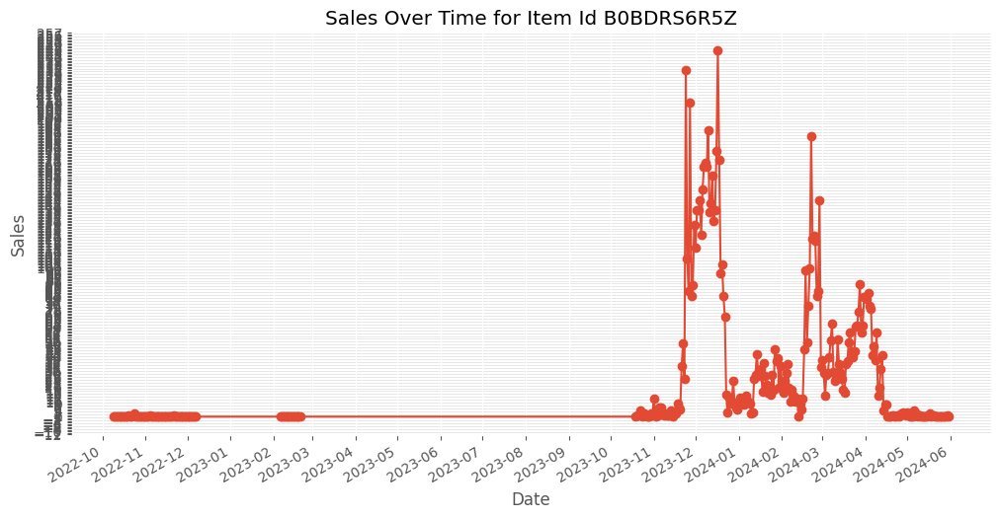

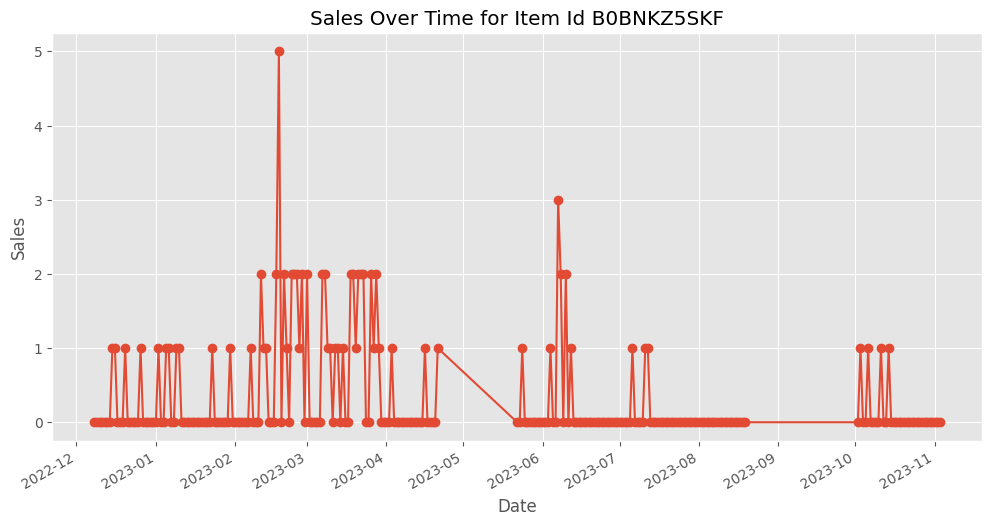

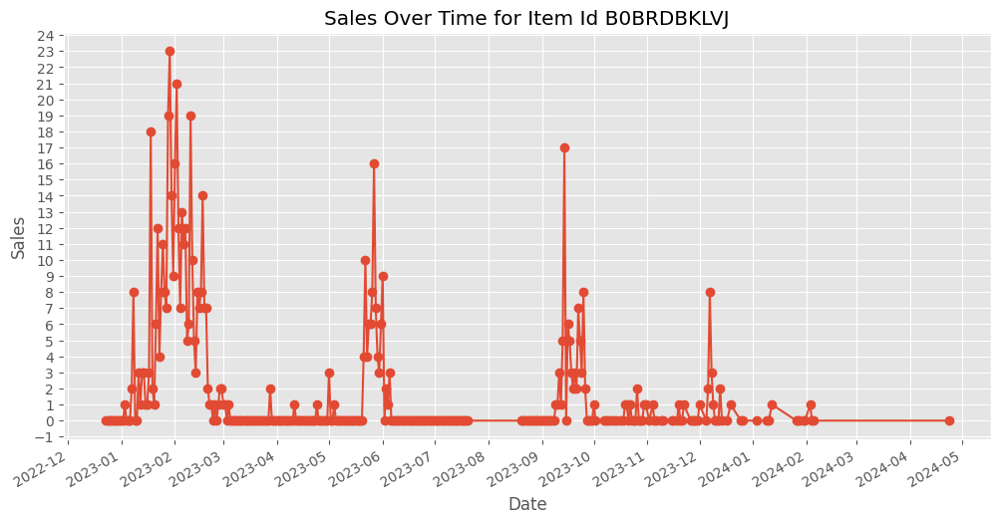

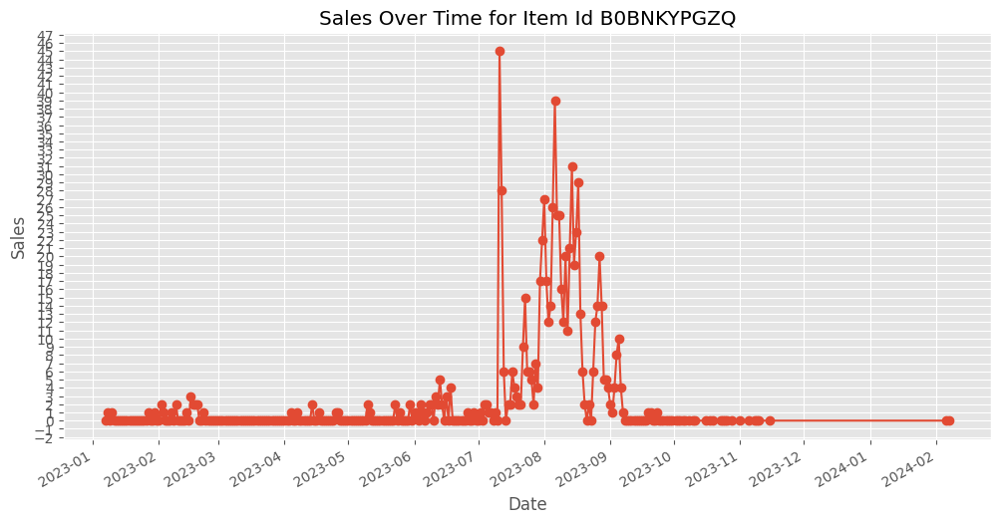

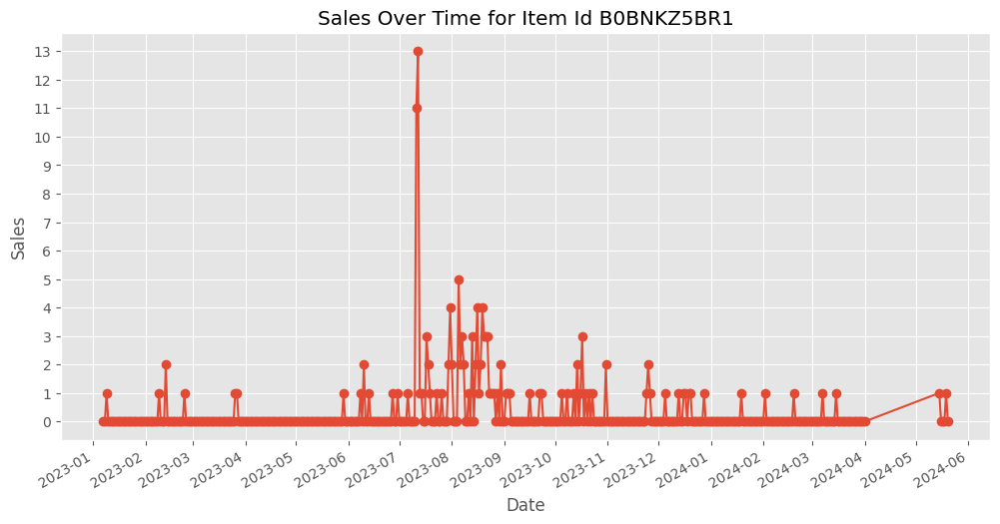

...

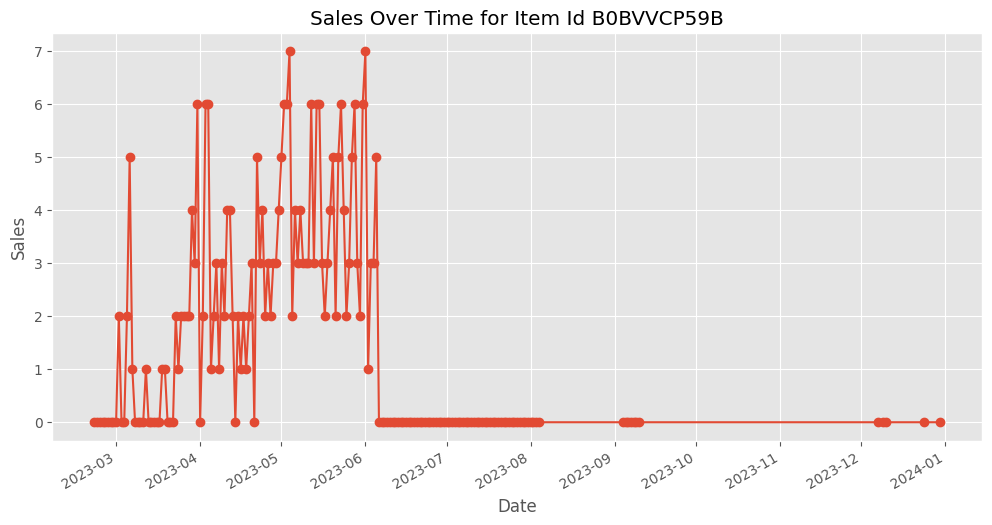

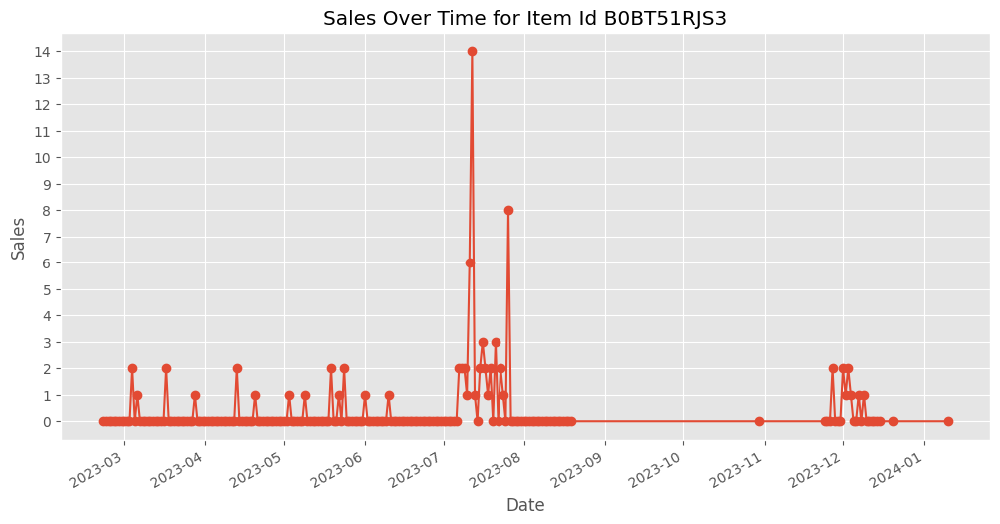

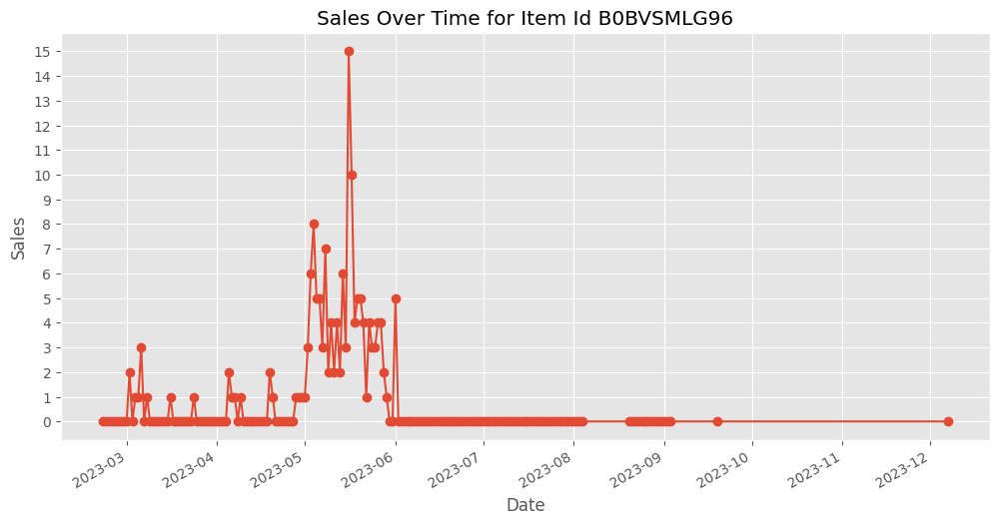

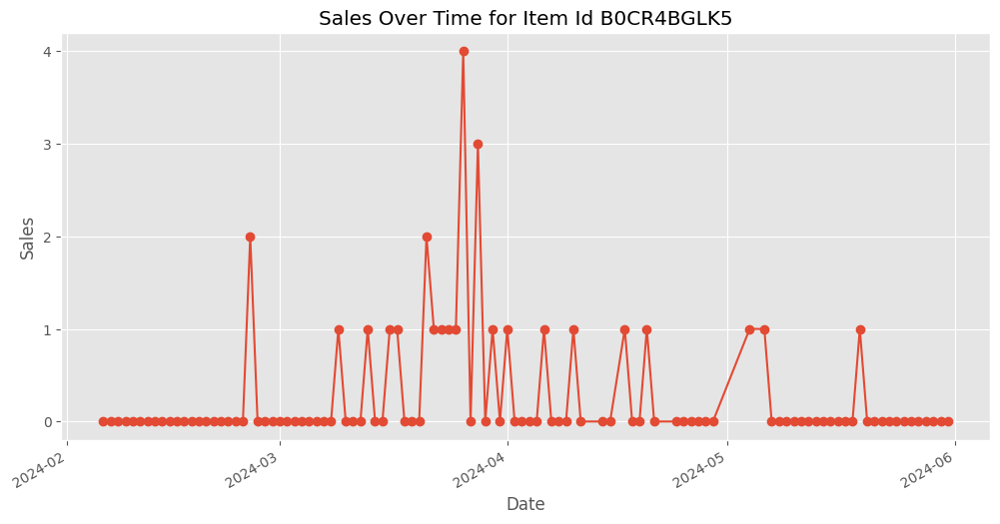

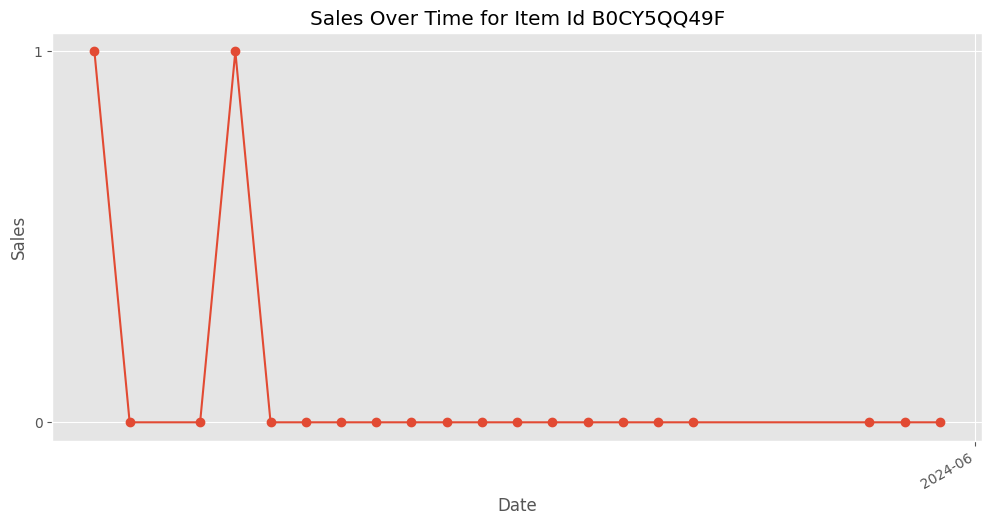

In [13]:
from matplotlib.ticker import MultipleLocator

# Use a valid Matplotlib style
plt.style.use('ggplot')  # Change to any available style if 'ggplot' is not preferred

# Generate graphs for non-stationary items
for item_id in non_stationary_items:
    df_item = df_cleaned[df_cleaned['Item Id'] == item_id]
    df_item_agg = df_item.groupby(['date']).agg({'units': 'sum'}).reset_index()
    
    plt.figure(figsize=(12, 6))
    plt.plot(df_item_agg['date'], df_item_agg['units'], marker='o', linestyle='-')
    
    # Format the date labels on x-axis
    plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
    plt.gcf().autofmt_xdate()  # Rotate date labels for better readability

    # Set y-axis to increment by 1 unit
    plt.gca().yaxis.set_major_locator(MultipleLocator(1))

    plt.title(f"Sales Over Time for Item Id {item_id}")
    plt.xlabel("Date")
    plt.ylabel("Sales")
    plt.grid(True)
    plt.show()

In [23]:
from scipy.stats import boxcox
def adfuller_test(series):
    result = adfuller(series)
    return result[1] <= 0.05  # p-value <= 0.05 indicates stationarity

def apply_boxcox_and_diff(series):
    # Apply Box-Cox transformation
    transformed_series, _ = boxcox(series + 1)  # Adding 1 to avoid issues with zero values
    # Apply first-order differencing
    diff_series = np.diff(transformed_series)
    return pd.Series(diff_series)  # Convert to pandas Series for ADF test compatibility

# Recheck stationarity for non-stationary items
for item_id in non_stationary_items:
    df_item = df_cleaned[df_cleaned['Item Id'] == item_id]
    df_item_agg = df_item.groupby(['date']).agg({'units': 'sum'}).reset_index()
    df_item_agg = df_item_agg.set_index('date')['units']
    
    # Apply Box-Cox and differencing
    try:
        transformed_diff_series = apply_boxcox_and_diff(df_item_agg)
        # Perform ADF test on transformed series
        is_stationary_after_transformation = adfuller_test(transformed_diff_series)
        if is_stationary_after_transformation:
            print(f"Item Id {item_id} is now stationary")
        else:
            print(f"Item Id {item_id} remains non-stationary")
    except Exception as e:
        print(f"An error occurred for Item Id {item_id}: {e}")

Item Id B0BDRS6R5Z is now stationary
Item Id B0BNKZ5SKF is now stationary
Item Id B0BRDBKLVJ is now stationary
Item Id B0BNKYPGZQ is now stationary
Item Id B0BNKZ5BR1 is now stationary
Item Id B0BNL1QKLV is now stationary
Item Id B0BNKY2YCQ is now stationary
Item Id B0BNL3ZHYM is now stationary
Item Id B0BVVCP59B is now stationary
Item Id B0BT51RJS3 is now stationary
Item Id B0BVSMLG96 is now stationary
Item Id B0CR4BGLK5 is now stationary
Item Id B0CY5QQ49F is now stationary


c:\Python311\Lib\site-packages\statsmodels\regression\linear_model.py:957: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2


In [29]:
# Create a DataFrame for the stationary items
df_stationary_items = df_cleaned[df_cleaned['Item Id'].isin(stationary_items)]

# Create a DataFrame for the non-stationary items that have now become stationary
df_stationary_after_transformation = df_cleaned[df_cleaned['Item Id'].isin(non_stationary_items)]

# Combine both DataFrames
df_stationary_combined = pd.concat([df_stationary_items, df_stationary_after_transformation])

# Reset index of the combined DataFrame
df_stationary_combined = df_stationary_combined.reset_index(drop=True)

# View the combined DataFrame
print("Combined Stationary DataFrame:")
print(df_stationary_combined.head())

Combined Stationary DataFrame:
                      ID       date     Item Id  \
0  2022-04-12_B09KDTS4DC 2022-04-12  B09KDTS4DC   
1  2022-04-12_B09MR2MLZH 2022-04-12  B09MR2MLZH   
2  2022-04-12_B09KSYL73R 2022-04-12  B09KSYL73R   
3  2022-04-12_B09KT5HMNY 2022-04-12  B09KT5HMNY   
4  2022-04-12_B09KTF8ZDQ 2022-04-12  B09KTF8ZDQ   

                                           Item Name  ad_spend anarix_id  \
0  NapQueen Elizabeth 8" Gel Memory Foam Mattress...       0.0  NAPQUEEN   
1  NapQueen 12 Inch Bamboo Charcoal Queen Size Me...       0.0  NAPQUEEN   
2     NapQueen Elsa 8" Innerspring Mattress, Twin XL       0.0  NAPQUEEN   
3        NapQueen Elsa 6" Innerspring Mattress, Twin       0.0  NAPQUEEN   
4     NapQueen Elsa 6" Innerspring Mattress, Twin XL       0.0  NAPQUEEN   

   units  unit_price  
0    0.0         0.0  
1    0.0         0.0  
2    0.0         0.0  
3    0.0         0.0  
4    0.0         0.0  


In [30]:
print(df_stationary_combined.columns)

Index(['ID', 'date', 'Item Id', 'Item Name', 'ad_spend', 'anarix_id', 'units',
       'unit_price'],
      dtype='object')


In [31]:
from scipy.stats import boxcox
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from statsmodels.tsa.arima.model import ARIMA
from keras.models import Sequential
from keras.layers import LSTM, Dense
import numpy as np
import pandas as pd

# Ensure 'date' is a datetime column and sort values safely
df_stationary_combined = df_stationary_combined.copy()  # Create a copy of the DataFrame
df_stationary_combined['date'] = pd.to_datetime(df_stationary_combined['date'])
df_stationary_combined.sort_values(by='date', inplace=True)
df_stationary_combined.set_index('date', inplace=True)

# Resample to daily frequency if needed
df_stationary_combined = df_stationary_combined.resample('D').sum().fillna(0)

# Check for non-positive values and add a constant to shift values
min_value = df_stationary_combined['unit_price'].min()
constant = 1e-6 - min_value if min_value <= 0 else 1e-6
df_stationary_combined['unit_price'] += constant

# Apply Box-Cox transformation
df_stationary_combined['units_boxcox'], lambda_ = boxcox(df_stationary_combined['unit_price'])

# Apply first-order differencing
df_stationary_combined['units_diff'] = df_stationary_combined['units_boxcox'].diff().dropna()

# Drop NA values created by differencing and Box-Cox
df_stationary_combined.dropna(inplace=True)

# Split into training and test sets
train, test = train_test_split(df_stationary_combined, test_size=0.2, shuffle=False)

# ARIMA Model
# Fit ARIMA model on Box-Cox transformed data
arima_model = ARIMA(train['units_boxcox'], order=(5, 1, 0))  # Example order, tune as needed
arima_fit = arima_model.fit()

# Forecast
arima_forecast_boxcox = arima_fit.forecast(steps=len(test))
# Inverse transform the Box-Cox forecast
arima_forecast = np.exp(arima_forecast_boxcox) - constant

# Evaluate
mse_arima = mean_squared_error(test['unit_price'], arima_forecast)
print(f"ARIMA MSE: {mse_arima}")

# LSTM Model
# Normalize data
scaler = MinMaxScaler(feature_range=(0, 1))
train_scaled = scaler.fit_transform(train[['units_boxcox']])
test_scaled = scaler.transform(test[['units_boxcox']])

# Prepare LSTM data
def create_dataset(data, time_step=1):
    X, y = [], []
    for i in range(len(data) - time_step):
        X.append(data[i:(i + time_step), 0])
        y.append(data[i + time_step, 0])
    return np.array(X), np.array(y)

time_step = 10  # Example time step, tune as needed
X_train, y_train = create_dataset(train_scaled, time_step)
X_test, y_test = create_dataset(test_scaled, time_step)

# Reshape for LSTM [samples, time steps, features]
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

# Build LSTM model
lstm_model = Sequential()
lstm_model.add(LSTM(50, return_sequences=True, input_shape=(time_step, 1)))
lstm_model.add(LSTM(50, return_sequences=False))
lstm_model.add(Dense(1))
lstm_model.compile(optimizer='adam', loss='mean_squared_error')

# Train LSTM model
lstm_model.fit(X_train, y_train, epochs=10, batch_size=32, verbose=1)

# Forecast
lstm_forecast_boxcox = lstm_model.predict(X_test)
lstm_forecast = np.exp(lstm_forecast_boxcox) - constant
y_test_actual = np.exp(y_test.reshape(-1, 1)) - constant

# Evaluate
mse_lstm = mean_squared_error(y_test_actual, lstm_forecast)
print(f"LSTM MSE: {mse_lstm}")


ARIMA MSE: inf



c:\Python311\Lib\site-packages\sklearn\metrics\_regression.py:446: RuntimeWarning: overflow encountered in square
  output_errors = np.average((y_true - y_pred) ** 2, axis=0, weights=sample_weight)



Epoch 1/10

20/20 [==============================] - 3s 6ms/step - loss: 0.0389
Epoch 2/10
20/20 [==============================] - 0s 6ms/step - loss: 0.0121
Epoch 3/10
20/20 [==============================] - 0s 6ms/step - loss: 0.0098
Epoch 4/10
20/20 [==============================] - 0s 6ms/step - loss: 0.0094
Epoch 5/10
20/20 [==============================] - 0s 7ms/step - loss: 0.0090
Epoch 6/10
20/20 [==============================] - 0s 6ms/step - loss: 0.0089
Epoch 7/10
20/20 [==============================] - 0s 6ms/step - loss: 0.0088
Epoch 8/10
20/20 [==============================] - 0s 7ms/step - loss: 0.0086
Epoch 9/10
20/20 [==============================] - 0s 6ms/step - loss: 0.0091
Epoch 10/10
5/5 [==============================] - 1s 3ms/step
LSTM MSE: 0.013160022845014406


In [ ]:
# from sklearn.svm import SVR


# test_data = pd.read_csv('./data/test.csv')

# test_data.head()

,ID,date,Item Id,Item Name,ad_spend,anarix_id,unit_price
0,2024-07-01_B09KDR64LT,2024-07-01,B09KDR64LT,"NapQueen Elizabeth 10"" Gel Memory Foam Mattres...",NaN,NAPQUEEN,0.0
1,2024-07-01_B09KDTS4DC,2024-07-01,B09KDTS4DC,"NapQueen Elizabeth 8"" Gel Memory Foam Mattress...",NaN,NAPQUEEN,0.0
2,2024-07-01_B09KDTHJ6V,2024-07-01,B09KDTHJ6V,"NapQueen Elizabeth 12"" Gel Memory Foam Mattres...",NaN,NAPQUEEN,0.0
3,2024-07-01_B09KDQ2BWY,2024-07-01,B09KDQ2BWY,"NapQueen Elizabeth 12"" Gel Memory Foam Mattres...",NaN,NAPQUEEN,0.0
4,2024-07-01_B09KDYY3SB,2024-07-01,B09KDYY3SB,"NapQueen Elizabeth 10"" Gel Memory Foam Mattres...",101.72,NAPQUEEN,1094.5


In [ ]:
# # Prepare data
# X_train = df[['ad_spend', 'unit_price']]
# y_train = df['units']
# X_test = test_data[['ad_spend', 'unit_price']]

# # Train SVR model
# svr_model = SVR(kernel='rbf', C=10, epsilon=0.1)
# svr_model.fit(X_train, y_train)

SVR(C=10)

In [ ]:
# X_test.isna().sum()
# X_test.fillna(0, inplace= True)
# # X_test.isna().sum()

C:\Users\shrey\AppData\Local\Temp\ipykernel_12220\1737049079.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_test.fillna(0, inplace= True)


ad_spend      0
unit_price    0
dtype: int64

In [ ]:
# # Predict and evaluate
# svr_predictions = svr_model.predict(X_test)

# # Save predictions
# submission = pd.DataFrame({
#     'ID': test_data['ID'],
#     'TARGET': svr_predictions
# })

In [ ]:
# submission.to_csv('sample_submission_svr.csv', index=False)